# Sources and Sinks - An Analysis of Bike Sharing in Montreal

by Elliott Kobelansky

## Summary 

This project analyzes trip-level data from Montreal’s Bixi bike-sharing system in 2024 (≈13 million rides). Using spatial and temporal analyses, I investigate how certain stations act as sources (net exporters of bikes) while others act as sinks (net importers). Results reveal a strong north–south divide across Sherbrooke Street, influenced by elevation, metro access, and land use. Time series and hourly analyses further highlight behavioral patterns like evening rush-hour dominance and weather sensitivity.

## Background: What is Bixi?

Bixi is Montreal’s public bike-sharing system, launched in 2009. It allows residents and visitors to rent bicycles for short trips across the city through a network of docking stations. Users can pick up a bike at one station and return it to any other station, making it a flexible and eco-friendly option for commuting, running errands, or exploring the city. Bixi has become an integral part of Montreal’s urban mobility, especially in dense neighborhoods, along commuting corridors, and near tourist areas. Fun fact: TIME magazine named Bixi one of the top 25 inventions of the past 25 years, and has since inspired bike-sharing platforms in cities around the world.

## Motivation: Why Study Bike Flow?

I live at the top of a fairly steep hill, and I often noticed that the nearby Bixi stations seemed to have more bikes leaving than returning. After all, who wants to bike uphill? Later, the idea came up again when a friend mentioned that the Bixi station near McGill University downtown was often empty, leaving them frustrated.

These experiences sparked my curiosity about the source–sink dynamics of Bixi stations: why and when do some consistently lose bikes while others accumulate them? This project explores that question, along with a few related ones about geography and temporal behavior. More broadly, it’s part of my interest in understanding transportation patterns in urban environments.

## Data & Setup

Ride data for this analysis comes from Bixi's [Open Data Portal](https://bixi.com/en/open-data), specifically trip-level data for 2024. Each record contains information about individual rides:
- Start Station, borough, and coordinates
- End station, borough, and coordinates
- Start time and end time

In total, this dataset includes more than 13 million trips!

Other sources include: 
- Climate Data: Environment Canada's [historical weather data](https://bixi.com/en/open-data), specifically the data collected at Montreal-Trudeau Airport in 2024 (Daily).
- Metro locations: The City of Montreal's [public transit dataset](https://donnees.montreal.ca/dataset/stm-traces-des-lignes-de-bus-et-de-metro).
- Elevation data: Queried using the [Open-Elevation API](https://wiki.openstreetmap.org/wiki/Open-Elevation).

A quick look at the trip dataset:

In [1]:
# Imports

import pandas as pd
import geopandas as gpd
import folium
from folium.plugins import TimeSliderChoropleth
import numpy as np
import branca.colormap as cm
import requests
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
import matplotlib.dates as mdates
import seaborn as sns
from shapely.geometry import Point, LineString
import matplotlib as mpl
import contextily as ctx
from matplotlib.animation import FuncAnimation

In [2]:
# Load Data

data = pd.read_csv("data.csv")
weather = pd.read_csv("weather_2024.csv")
stm_lines = gpd.read_file("stm/stm_lignes_sig.shp")
elevations = pd.read_csv("elevations.csv")

In [6]:
data.head()

,STARTSTATIONNAME,STARTSTATIONARRONDISSEMENT,STARTSTATIONLATITUDE,STARTSTATIONLONGITUDE,ENDSTATIONNAME,ENDSTATIONARRONDISSEMENT,ENDSTATIONLATITUDE,ENDSTATIONLONGITUDE,STARTTIMEMS,ENDTIMEMS
0,Métro Champ-de-Mars (Viger / Sanguinet),Ville-Marie,45.510253,-73.556777,St-Antoine / Jean-Paul Riopelle,Ville-Marie,45.502940,-73.560640,1704230756167,1.704231e+12
1,Métro Place-d'Armes (Viger / St-Urbain),Ville-Marie,45.506314,-73.559671,de Maisonneuve / Aylmer (est),Ville-Marie,45.505386,-73.570432,1704232888826,1.704233e+12
2,Émile-Duployé / Sherbrooke,Le Plateau-Mont-Royal,45.527195,-73.564526,Parc Molson (d'Iberville / Beaubien),Rosemont - La Petite-Patrie,45.549022,-73.591982,1704238154678,1.704239e+12
3,Marmier / St-Denis,Rosemont - La Petite-Patrie,45.531027,-73.598623,Roy / St-André,Le Plateau-Mont-Royal,45.521564,-73.570367,1704232695740,1.704233e+12
4,Marmier / St-Denis,Rosemont - La Petite-Patrie,45.531027,-73.598623,Parc Molson (d'Iberville / Beaubien),Rosemont - La Petite-Patrie,45.549022,-73.591982,1704243796167,1.704244e+12


In [3]:
# Data Cleaning

# ---------------------------------------------------------------------
# ----------------- STATION AGGREGATE DATA --------------------------
# ---------------------------------------------------------------------


# Number of trips starting/ending at each station
start_counts = (
    data.groupby("STARTSTATIONNAME")
    .agg(start_count=("STARTSTATIONNAME", "count"),
         lat=("STARTSTATIONLATITUDE", "first"),
         lon=("STARTSTATIONLONGITUDE", "first"))
    .reset_index()
)

end_counts = (
    data.groupby("ENDSTATIONNAME")
    .agg(end_count=("ENDSTATIONNAME", "count"))
    .reset_index()
)

# Merging these into one table
stations_df = pd.merge(
    start_counts,
    end_counts,
    how="outer",
    left_on="STARTSTATIONNAME",
    right_on="ENDSTATIONNAME"
)

# Clean names
stations_df = stations_df.rename(columns={"STARTSTATIONNAME": "name"})

# Fill NaNs with 0 for stations that appear only in start or end
stations_df["start_count"] = stations_df["start_count"].fillna(0)
stations_df["end_count"] = stations_df["end_count"].fillna(0)

# Keep only relevant columns and clean
stations_df = stations_df[["name", "lat", "lon", "start_count", "end_count"]]
stations_df = stations_df.dropna(subset=['lat','lon'])

# Net delta and activity per station
stations_df["net_flow"] = stations_df["end_count"] - stations_df["start_count"]
stations_df['activity'] = stations_df['start_count'] + stations_df['end_count']
stations_df['normed_net_flow'] = stations_df['net_flow'] / stations_df['activity']

# There are a couple of outlier stations that seem to be used for technical
# or ad-hoc purposes in the database.
stations_df = stations_df[(stations_df['activity'] >= 250) & (np.abs(stations_df['normed_net_flow']) < 0.9)]

# To GeoDataFrame (for mapping)
station_gdf = gpd.GeoDataFrame(
    stations_df,
    geometry=gpd.points_from_xy(stations_df.lon, stations_df.lat),
    crs="EPSG:4326"
)

# Clean NAs
station_gdf = station_gdf[station_gdf.geometry.notnull() & ~((station_gdf.geometry.x == 0) & (station_gdf.geometry.y == 0))]

#  Add elevation from OpenStreetMaps

def get_elevation(lat, lon):
    url = "https://api.open-elevation.com/api/v1/lookup"
    params = {"locations": f"{lat},{lon}"}
    r = requests.get(url, params=params).json()
    return r['results'][0]['elevation']

# The API is rate-limited to 100 requests per second. This takes around 10 minutes to run.
# station_gdf['elevation'] = station_gdf.apply(lambda row: get_elevation(row.geometry.y, row.geometry.x), axis=1)

# I have already called the API and have the data stored in elevations.csv
station_gdf = station_gdf.merge(elevations, on='name', how='inner')

# ----------------------------------------------------------
# ---------------- WEATHER ---------------------------------
# ----------------------------------------------------------

weather_df = weather[['Month', 'Day', 'Total Precip (mm)', 'Mean Temp (°C)']]
weather_df = weather_df.rename(columns={'Total Precip (mm)': 'precip', 'Mean Temp (°C)': 'temp'})
weather_df['date'] = pd.to_datetime({'year': 2024, 'month': weather_df['Month'], 'day': weather_df['Day']})
weather_df = weather_df.set_index('date').sort_index()

# -----------------------------------------------------------------------------------------
# ----------------- TRIP TIME SERIES ---------------------------------------------------------
# ------------------------------------------------------------------------------------------

trips_df = data.copy()

# Convert to datetime object in local timezone (this adjusts for daylight savings automatically)
trips_df['start_time'] = pd.to_datetime(trips_df['STARTTIMEMS'], unit='ms').dt.tz_localize('UTC').dt.tz_convert('America/Toronto')
trips_df['end_time'] = pd.to_datetime(trips_df['ENDTIMEMS'], unit='ms').dt.tz_localize('UTC').dt.tz_convert('America/Toronto')

# Extract start/end hour (of day) and weekday
trips_df = trips_df.dropna(subset=['start_time', 'end_time'])
trips_df['start_hour'] = trips_df['start_time'].dt.hour.astype(int) # 0 to 23 
trips_df['end_hour'] = trips_df['end_time'].dt.hour.astype(int)
trips_df['weekday'] = trips_df['start_time'].dt.weekday  # 0=Mon, 6=Sun

# Group by sation, get number of trips in that hour through the entire year
hourly_out = trips_df.groupby(['STARTSTATIONNAME', 'start_hour']).size().unstack(fill_value=0)
hourly_in = trips_df.groupby(['ENDSTATIONNAME', 'end_hour']).size().unstack(fill_value=0)

# Merge into one df
stations_hourly_df = hourly_out.add_prefix('out_').merge(
    hourly_in.add_prefix('in_'),
    left_index=True, right_index=True,
    how='outer'
).fillna(0)

stations_hourly_df.reset_index(inplace=True)
stations_hourly_df.rename(columns={'index': 'name'}, inplace=True)

# Merge Geodata
stations_hourly_df = stations_hourly_df.merge(
    station_gdf[['name', 'geometry']],
    on='name',
    how='left'
)
stations_hourly_df = gpd.GeoDataFrame(stations_hourly_df, geometry='geometry', crs="EPSG:4326")

# Fix for weird thing where it gets treated as a float
for h in range(24):
    stations_hourly_df[f'delta_{h}'] = stations_hourly_df[f'in_{h}'] - stations_hourly_df[f'out_{h}'] 

# Compute NNF for each station
hours = range(0,24)
for h in hours:
    total = stations_hourly_df[f'out_{h}'] + stations_hourly_df[f'in_{h}']
    total = total.replace(0, 1)  # avoid division by zero
    stations_hourly_df[f'nnf_{h}'] = stations_hourly_df[f'delta_{h}'] / total

# Get total counts per hour across all stations
out_cols = [c for c in stations_hourly_df.columns if c.startswith('out_')]
in_cols = [c for c in stations_hourly_df.columns if c.startswith('in_')]
total_out = stations_hourly_df[out_cols].sum()
total_in = stations_hourly_df[in_cols].sum()

# Group trips by weekday or weekend
weekday_trips_df = trips_df[trips_df['weekday'] < 5]
weekend_trips_df = trips_df[trips_df['weekday'] >= 5]
weekday_hourly_df = weekday_trips_df.groupby('start_hour').size()
weekend_hourly_df = weekend_trips_df.groupby('start_hour').size()

# Total trips per day, join on precipitation data
daily_df = trips_df.groupby(trips_df['start_time'].dt.date).count()
daily_df['start_time'] = pd.to_datetime(daily_df['start_time'])
daily_df.index = pd.to_datetime(daily_df.index)
daily_df = daily_df.merge(weather_df, left_index=True, right_on='date', how='left')


# -----------------------------------------------------------------------------------------
# ----------------- METRO DATA ---------------------------------------------------------
# ------------------------------------------------------------------------------------------

# Limit to metro lines
metro_lines = stm_lines[stm_lines['route_name'].str.contains('Ligne')].drop_duplicates(subset=['route_name'])
all_coords = [list(geom.coords) for geom in metro_lines.geometry if geom is not None]
flattened_coords = [coord for sublist in all_coords for coord in sublist]

# Want both of these in EPSG32198 which is a projected coordinate system in metres
station_gdf_m = station_gdf.to_crs(epsg=32198) 
metro_gdf_m = metro_lines.to_crs(epsg=32198)

# Get nearest metro station for each bixi station
station_gdf_m = gpd.sjoin_nearest(
    station_gdf_m, 
    metro_gdf_m[['geometry']],
    how='left', 
    distance_col='dist_to_metro_m'
)
# Filter out the stations in the middle of nowhere
# (these are off-island and useless for analysis of this specific feature
station_gdf_m = station_gdf_m[station_gdf_m['dist_to_metro_m'] < 8000]

# Citywide Net Flow

To understand long-term spatial trends, I aggregated all 2024 Bixi trips by station and computed two key metrics for each station: normalized net flow ($\delta$) and total activity ($a$). The resulting map below highlights source–sink behavior across Montreal.

For a given station, let
$$x = (x_{\text{in}}, x_{\text{out}}),$$
where:
- $x_{\text{in}} = $ total number of trips ending at the station over the year
- $x_{\text{out}} = $ total number of trips starting at the station over the year.

Then,

- Circle color represents the normalized net flow:
   $$\delta = \frac{x_{\text{in}} - x_{\text{out}}}{x_{\text{in}} + x_{\text{out}}}$$

  Red stations are sources (more bikes leaving than arriving) and green stations are net sinks (more bikes arriving than leaving).

- Circle size represents total activity

    $$a = x_{\text{in}} + x_{\text{out}}$$


The map is interactive! Try moving around, zooming in, and clicking on stations.

In [4]:
# Generate Sources vs Sinks Map

# Base map centered on Montreal
m = folium.Map(location=[45.5, -73.6], zoom_start=12)

# Radius scaling by trip count
activity = np.abs(station_gdf['activity'])
radius_min, radius_max = 5, 20
radii = radius_min + (activity - activity.min()) / (activity.max() - activity.min()) * (radius_max - radius_min)

# Color mapping by normed net flow
abs_max_nnf = abs(max(station_gdf['normed_net_flow'].min(), station_gdf['normed_net_flow'].max()))
colormap = cm.LinearColormap(
    colors=['red', 'gray', 'green'],
    index=[-abs_max_nnf, 0, abs_max_nnf],
    vmin=-abs_max_nnf,
    vmax=abs_max_nnf
)

# Add points!
for (_, row), r in zip(station_gdf.iterrows(), radii):
    popup_text = (
        f"{row['name']}<br>"
        f"Out: {row['start_count']}<br>"
        f"In: {row['end_count']}<br>"
        f"NNF: {round(row['normed_net_flow'], 2)}"
    )
    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        radius=r,
        color=colormap(row['normed_net_flow']),
        fill=True,
        fill_opacity=0.9,
        popup=popup_text
    ).add_to(m)

# Color Legend
colormap.caption = "Normalized Net Flow (IN - OUT) / (IN + OUT)"
colormap.add_to(m)

m

## Interpreting Spatial Patterns

Beyond the expected concentration of activity downtown, one striking feature emerges: a sharp north-eastward dividing line between “green” stations (sinks) and “red” stations (sources). This line aligns almost perfectly with Sherbrooke Street, which acts as a natural boundary in Montreal’s urban layout. North of Sherbrooke is predominantly residential, where bikes tend to leave stations in the morning (sources). South of Sherbrooke is predominantly commercial, where bikes arrive more often (sinks).

### Key Neighborhoods

The Plateau Mont-Royal neighborhood is an area with high activity. Many bikes are leaving stations here, likely because this is a residential neighborhood. The general community is on the younger side. Combined with limited parking in the neighborhood, cycling naturally emerges as a convenient alternative.

The Downtown area is almost uniformly filled with sink-type stations. Not only is it slightly downhill from neighborhoods above Sherbrooke, but it’s also a major work and entertainment hub. People likely commute here in the morning and return home by other means later in the day. 

Around the Old Port, tourism likely amplifies sink behaviour, as visitors likely commute to these popular locations.

### Likely Factors

Here are some proposed factors that are likely to affect sink/source behaviour:
- Elevation: Stations at higher altitudes tend to be sources.
- Proximity to a metro station: Metro-adjacent stations show higher polarity and activity
- Land use: Residential vs commercial areas influence flow direction.
- Tourist hotspots: Increase inbound trips at popular destinations.
- Population density: Denser areas tend to generate more activity.

# Top 5: Normalized Net Flow and Activity

For context (and out of curiosity), below are the top 5 stations ranked by the absolute value of normalized net flow and total activity.

## A Special Case: Métro Villa-Maria

Funnily enough, this is one of the stations that initally had me wondering about these Bixi stations. Among all 1062 stations, it has the strongest normalized net flow, acting as a clear source. Here are some characteristics of this station

- Positioned on a steep slope, discouraging biking uphill.
- Located next to a metro station, a school, and a cégep (college)
- Situated east of Monkland Village, a predominantly residential area.
- Commuters likely walk uphill in the morning and cycle downhill in the evening.

On a personal note, I experience a similar pattern in this area, though using the metro rather than Bixi: when heading downtown, I typically walk downhill to Sherbrooke street and take the transit there, while on the return trip I get off at Villa-Maria to avoid the strenuous uphill walk (I will be able to tell my future grandkids I had the luxury of walking downhill both ways to school). This behavior aligns closely with the Bixi station’s role as a net source. 

In [31]:
stations_df['abs_nnf'] = stations_df['normed_net_flow'].abs()
x = stations_df.sort_values(by="abs_nnf", ascending=False).head(5)
x.drop('abs_nnf', axis=1)

,name,lat,lon,start_count,end_count,net_flow,activity,normed_net_flow
574,Métro Villa-Maria (de Monkland / Décarie),45.478968,-73.619599,14717.0,6990.0,-7727.0,21707.0,-0.355968
793,Square-Victoria (Viger / du Square-Victoria),45.502085,-73.562941,15685.0,31086.0,15401.0,46771.0,0.329285
791,Square Victoria (Viger / du Square-Victoria),45.502060,-73.562950,11195.0,22074.0,10879.0,33269.0,0.327001
554,Métro Place-d'Armes (Viger / St-Urbain),45.506314,-73.559671,16325.0,30485.0,14160.0,46810.0,0.302499
923,Viger / Chenneville,45.505312,-73.560891,10136.0,18594.0,8458.0,28730.0,0.294396


In [6]:
stations_df.sort_values(by='activity', ascending=False).head(5)

,name,lat,lon,start_count,end_count,net_flow,activity,normed_net_flow
543,Métro Mont-Royal (Utilités publiques / Rivard),45.524236,-73.581552,117746.0,110896.0,-6850.0,228642.0,-0.029960
1114,du Mont-Royal / Clark,45.519410,-73.586850,107638.0,94981.0,-12657.0,202619.0,-0.062467
465,Marquette / du Mont-Royal,45.532218,-73.575431,78799.0,76797.0,-2002.0,155596.0,-0.012867
394,Laurier / St-Denis,45.527148,-73.589479,84152.0,71121.0,-13031.0,155273.0,-0.083923
1089,des Pins / St-Laurent,45.515228,-73.575096,79154.0,72992.0,-6162.0,152146.0,-0.040501


# Simple Quantitative Relationships

Two key factors appear to influence a station's behaviour: elevation and proximity to metro stations. The scatter plots below illustrate how these factors relate to normalized net flow ($\delta$) and total activity ($a$).

### Elevation vs NNF

As expected, stations at higher elevations tend to act as sources, while those at lower elevations tend to be sinks. A simple least-squares regression gives

$$R^2 = 0.38 \quad (n = 1062)$$

indicating a moderate correlation between elevation and normalized net flow.

### Elevation vs Activity

There is no significant correlation between elevation and total activity; high or low stations can be either busy or quiet depending on other factors.

### Metro Proximity vs NNF

Busier parts of the city are naturally more likely to have nearby metro stations. Metro proximity appears to be a “necessary but not sufficient” condition for a station to exhibit strong source or sink behavior.

Through "very rigorous" eyeballing, an approximate upper bound for the absolute value of normalized net flow can be described by:

$$|\delta| \leq 0.3 e^{- \sqrt{x} / 30},$$

where $x$ is the distance to the nearest metro station, in metres.

### Metro Proximity vs Activity

Similarly, station activity appears bounded by metro proximity. A rough upper bound for total activity is given by:

$$ a \leq 200000 e^{-x/1250}.$$

These relationships suggest that proximity to transit and elevation do influence flow and activity, but there are definitely other factors in play.


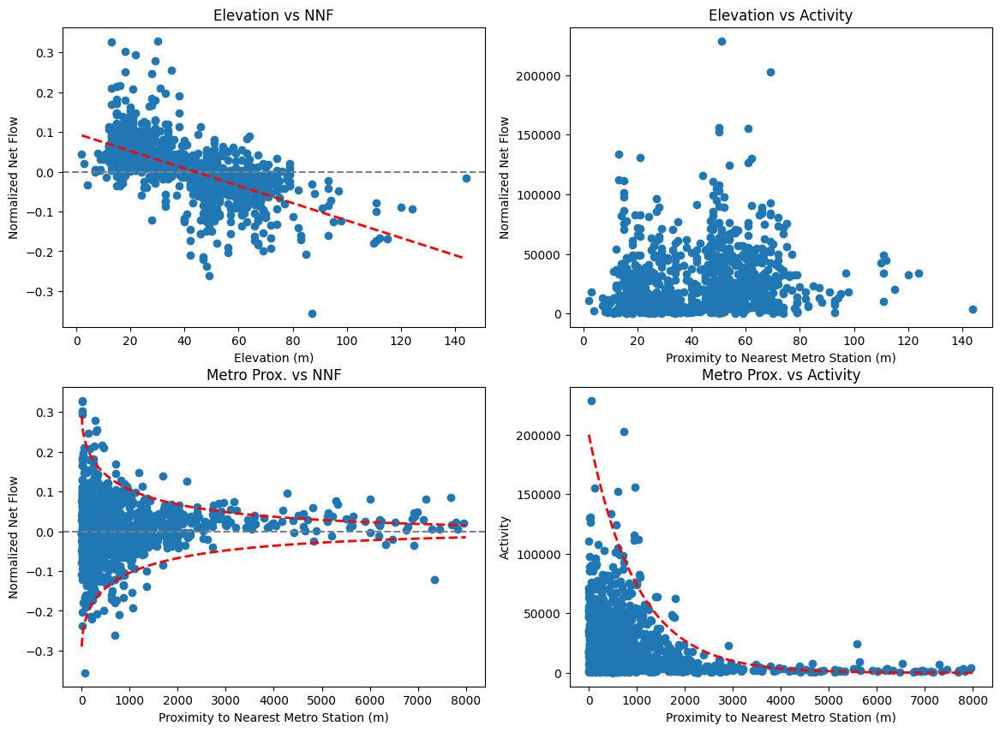

In [40]:
# Plot various Relationships

x = np.linspace(1, 8000, 500)

# Station Elevation vs NNF
plt.figure(figsize=(14,10))

plt.subplot(2, 2, 1)
plt.scatter(data=station_gdf_m, x='elevation', y='normed_net_flow')#, hue='normed_net_flow', palette='RdYlGn', edgecolor=None)
plt.axhline(0, color='gray', linestyle='--')  # reference line for balanced stations
sns.regplot(data=station_gdf, x='elevation', y='normed_net_flow', scatter=False, color='red', line_kws={'linewidth':2, 'linestyle':'--'}, ci=None)
plt.xlabel("Elevation (m)")
plt.ylabel("Normalized Net Flow")
plt.title("Elevation vs NNF")

plt.subplot(2, 2, 2)
plt.scatter(data=station_gdf_m, x='elevation', y='activity')#, hue='activity', palette='RdYlGn', edgecolor=None)
plt.xlabel("Proximity to Nearest Metro Station (m)")
plt.ylabel("Normalized Net Flow")
plt.title("Elevation vs Activity")

# Metro Distance vs NNF
plt.subplot(2, 2, 3)
plt.scatter(data=station_gdf_m, x='dist_to_metro_m', y='normed_net_flow')#, hue='normed_net_flow', palette='RdYlGn', edgecolor=None)
plt.axhline(0, color='gray', linestyle='--')  # reference line for balanced stations
y = 0.3 * np.exp(-np.sqrt(x) / 30)
plt.plot(x, y, color='red', linewidth=2, linestyle="--")
plt.plot(x, -y, color='red', linewidth=2, linestyle="--")
plt.xlabel("Proximity to Nearest Metro Station (m)")
plt.ylabel("Normalized Net Flow")
plt.title("Metro Prox. vs NNF")

# Metro Distance vs Activity
plt.subplot(2, 2, 4)
plt.scatter(data=station_gdf_m, x='dist_to_metro_m', y='activity')#, hue='activity', palette='RdYlGn', edgecolor=None)
y =  200000 * np.exp(-x / 1000)
plt.plot(x, y, color='red', linewidth=2, linestyle="--")

plt.xlabel("Proximity to Nearest Metro Station (m)")
plt.ylabel("Activity")
plt.title("Metro Prox. vs Activity")
plt.show()

In [51]:
# Least squares on top left graph

x = station_gdf_m['elevation']
y = station_gdf_m['normed_net_flow']

m, b = np.polyfit(x, y, 1)
m, b

# Manual R^2 to avoid importing yet another package
ss_res = np.sum((y - (m * x + b))**2)        
ss_tot = np.sum((y - np.mean(y))**2)    
r2 = 1 - ss_res/ss_tot

In [ ]:
# assume 'data' has STARTSTATIONNAME, ENDSTATIONLATITUDE/LONGITUDE, STARTSTATIONLATITUDE/LONGITUDE
data['dx'] = data['ENDSTATIONLONGITUDE'] - data['STARTSTATIONLONGITUDE']
data['dy'] = data['ENDSTATIONLATITUDE'] - data['STARTSTATIONLATITUDE']

# group by station to compute mean vector
station_vectors = data.groupby('STARTSTATIONNAME').agg(
    start_lat=('STARTSTATIONLATITUDE','first'),
    start_lon=('STARTSTATIONLONGITUDE','first'),
    avg_dx=('dx','mean'),
    avg_dy=('dy','mean'),
    trip_count=('dx','count')
).reset_index()

# convert to GeoDataFrame


station_vectors = station_vectors[station_vectors['trip_count'] > 100]

station_vectors_gdf = gpd.GeoDataFrame(
    station_vectors,
    geometry=gpd.points_from_xy(station_vectors.start_lon, station_vectors.start_lat),
    crs="EPSG:4326"
)

station_vectors_gdf['norm'] = np.sqrt(station_vectors_gdf['avg_dx']**2 + station_vectors_gdf['avg_dy']**2)
station_vectors_gdf = station_vectors_gdf[station_vectors_gdf['norm'] < 0.1]

# Temporal Dynamics

With the spatial source–sink patterns established, we can now examine how Bixi usage evolves over time.

## Trips Per Day

A natural first question is: how does daily Bixi usage evolve over the year? A simple first observation is that, as expected, trips are heavily concentrated during the warmer months.

The data is surprisingly noisy: while there seems to be a weekly cyclic pattern reflecting weekday commuting (vs weekend commuting), day-to-day variations can reach up to 20,000 trips.

Most downward spikes can be attributed to two main causes:

- Rainfall: Days with 10 mm or more of precipitation are marked on the graph. One extreme case (pink dot) was a day with 14 cm of rain, which led to a drop of around 60000 trips.

- Holidays and holiday-adjacent weekends: National holidays reduce weekday commuting. For example:

    - June 24 (St-Jean-Baptiste Day), July 1 (Canada Day), and September 2 (Labour Day) coincide with long weekends during which residents might travel elsewhere. 

    - October 14 (Thanksgiving) also explains a notable decrease in trips, i.e. the major downwards spike in October.

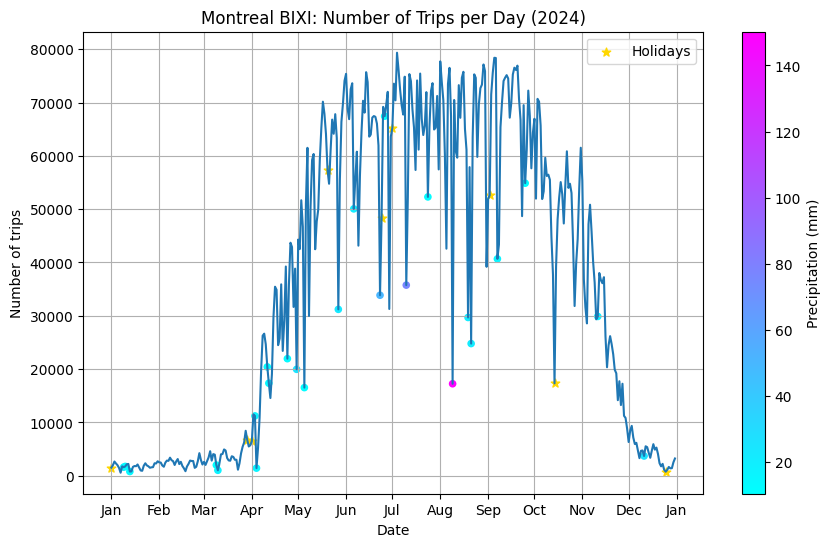

In [94]:
# Trips per day plot

holidays_2024 = pd.to_datetime([
    '2024-01-01',  # New Year's Day
    '2024-03-29',  # Good Friday
    '2024-04-01',  # Easter Monday
    '2024-05-20',  # Victoria Day / National Patriotes Day
    '2024-06-24',  # Fête Nationale / Jean Baptiste Day
    '2024-07-01',  # Canada Day
    '2024-09-02',  # Labour Day
    # '2024-09-30',  # National Day for Truth and Reconciliation, not a day off (it should be!)
    '2024-10-14',  # Thanksgiving Day
    '2024-12-25'   # Christmas Day
])

plt.figure(figsize=(10,6))

plt.plot(daily_df.index, daily_df.values[:, 0])
rain = daily_df[daily_df['precip'] >= 10]
scatter = plt.scatter(rain.index, rain.values[:, 0], marker='o', c=rain['precip'], cmap='cool', s=20)

holidays = daily_df[daily_df.index.isin(holidays_2024)]
plt.scatter(holidays.index, holidays.values[:, 0], marker='*', c="gold", s=40, label='Holidays')

plt.xlabel('Date')
plt.ylabel('Number of trips')
plt.title('Montreal BIXI: Number of Trips per Day (2024)')
ax = plt.gca()
ax.xaxis.set_major_locator(mdates.MonthLocator())
ax.xaxis.set_major_formatter(mdates.DateFormatter('%b'))
plt.legend()
plt.colorbar(scatter, label='Precipitation (mm)')
plt.grid(True)
plt.show()

## Hourly Flow

Beyond daily patterns, we can examine how Bixi usage varies by hour. The graph below shows total trip counts for 2024, grouped by hour. As expected, there are two prominent rush-hour peaks, but interestingly, the evening peak is consistently higher than the morning.

The inflow and outflow curves closely mirror each other, due to the fact that most trips are short and typically under one hour (so, on average, most trips start and end in the same hour).

### Evening (5pm) Dominance

Several factors likely contribute to the evening rush hour being more active:

- Montreal's hilly terrain may lead commuters to take transit uphill in the morning and cycle downhill in the evening.
- Evening rides may often include recreational trips, which are less common in the morning.
- Morning start times tend to be more staggered, while end times are more concentrated (in terms of work hours).

My theory is that factors like these accumulate and explain this pronounced 5pm spike.

### Weekday vs. Weekend Patterns

Human behaviour is obviously significantly different between weekday and weekends. Separating the data reveals:
- Weekdays: The curve is very close to the overall daily pattern, dominated by rush hours.
- Weekends: Trip patterns form a more sinusoidal (leisure-oriented) curve, mostly independent of the typical commuting times. 

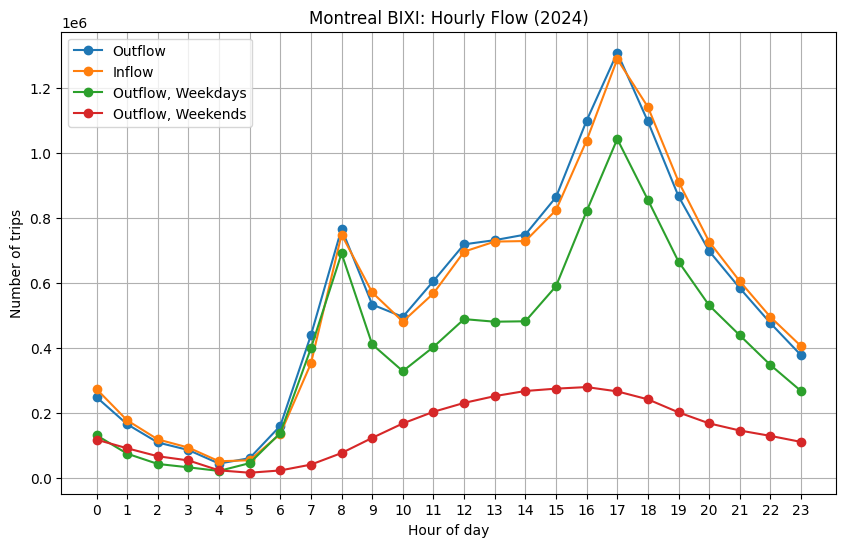

In [7]:
# Hourly Bixi Flow Plot 

plt.figure(figsize=(10,6))
plt.plot(range(0, 24), total_out.values, label='Outflow', marker='o')
plt.plot(range(0, 24), total_in.values, label='Inflow', marker='o')
plt.plot(range(0, 24), weekday_hourly_df.values, label='Outflow, Weekdays', marker='o')
plt.plot(range(0, 24), weekend_hourly_df.values, label='Outflow, Weekends', marker='o')
plt.xlabel('Hour of day')
plt.ylabel('Number of trips')
plt.title('Montreal BIXI: Hourly Flow (2024)')
plt.xticks(range(0,24))
plt.grid(True)
plt.legend()
plt.show()


## Combining Everything: NNF per Hour

To capture the dynamic behavior of Bixi stations throughout the day, here is an animated map showing the hourly evolution of normalized net flow (NNF) at each station. *(Note: make sure to press the "play" button on the toolbar below)*.

Again, the color represents the station’s NNF, with red indicating sources (more bikes leaving than arriving) and green indicating sinks (more bikes arriving than leaving), and size represents total station activity.

Key Observations
- Morning rush hour: The residential/commercial divide is striking. Stations north of Sherbrooke Street are mostly red (sources), while downtown stations are green (sinks). This clearly reflects commuter flow.
- Evening rush hour: Activity is higher overall (as seen in the graph above), but the polarization between sources and sinks is less extreme. Bikes are moving across more of the city, likely reflecting a mix of leisure trips, errands, and people returning home from various neighborhoods rather than a strict commute. Certain areas have more notable polarization, such as the McGill area which clearly becomes a net source around 5pm.
- Late-night behavior (12 AM – 4 AM): Surprisingly, there is quite the late-night activity in the Plateau. With metros closed, biking seems to serve as a convenient late-night transport option, likely for nightlife-related trips. Meanwhile, downtown stations see almost no activity during these hours, which is quite the contrast to the busy daytime patterns.

### The Dynamic Nature of Net Flow

Net flow clearly fluctuates throughout the day rather than remaining stable. Even stations that ranked highly in the “top net flow” lists do not maintain a consistent source or sink status at all hours. For example, a station may act as a strong source during the morning commute, sending many bikes downhill toward downtown, but by mid-afternoon it may see little net movement, or even reverse to a slight sink as people take bikes back home. This shows that net flow is inherently dynamic. A high net-flow station in the yearly aggregate may only achieve that status during a few key hours. For the rest of the day, it may behave more like a neutral or low-activity station.

In [26]:
# Evolution of NNF by Station Map

from IPython.display import HTML
mpl.rcParams['animation.embed_limit'] = 50_000_000  # e.g., 50 MB

stations_web = stations_hourly_df.to_crs(epsg=3857)

# Bounding box
x_min, y_min, x_max, y_max = stations_web.total_bounds


# Setup figure
fig, ax = plt.subplots(figsize=(10,10))
ax.set_xlim(x_min, x_max)
ax.set_ylim(y_min, y_max)
ax.set_aspect('equal')
ax.set_axis_off()


# Color normalization and colorbar
norm = mpl.colors.Normalize(vmin=-1, vmax=1)
sm = plt.cm.ScalarMappable(cmap='PiYG', norm=norm)
sm.set_array([])
cbar = fig.colorbar(sm, ax=ax, shrink=0.7)
cbar.set_label("NNF")

# Radius normalization
for h in range(0, 24):
    activity = stations_web[f'in_{h}'] + stations_web[f'out_{h}']
    radius_min, radius_max = 2, 15
    radii = radius_min + (activity - activity.min()) / (activity.max() - activity.min()) * (radius_max - radius_min)
    stations_web[f'r_{h}'] = radii

# Drop rows with missing geometry
filtered = stations_web.dropna(subset=['geometry'])

# Zoom
ax.set_xlim(filtered.geometry.x.min() + 10000, filtered.geometry.x.max() - 20000)
ax.set_ylim(filtered.geometry.y.min() + 5000, filtered.geometry.y.max() - 20000)

# Add basemap
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Voyager)

# Prepare scatter plot (will be updated)
scat = ax.scatter(
    filtered.geometry.x, filtered.geometry.y,
    c=filtered['nnf_0'], cmap='PiYG', s=filtered['r_0'], alpha=0.95, edgecolor='black', linewidth=0.25
)

def update(hour):
    # Update scatter color
    scat.set_array(filtered[f'nnf_{hour}'])
    scat.set_sizes(filtered[f'r_{hour}']**2)
    ax.set_title(f'Bixi Station NNF: {hour}:00', fontsize=16)

plt.close(fig)

# Animate
anim = FuncAnimation(fig, update, frames=24, interval=500)

HTML(anim.to_jshtml())

# So, I guess that answered my question...

This was a fun little investigation. Nothing that can’t be explained with a bit of basic human behavioral logic, but it’s satisfying to see my suspicions confirmed with actual data.

Pro tip: Always make sure you are using the same coordinate system across your geospatial data!!! Would have saved one or two headaches. 